In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import sys
sys.path.append('/n/home12/binxuwang/Github/Neuro-ActMax-GAN-comparison')
import torch as th
from core.utils.GAN_utils import upconvGAN, Caffenet
from core.utils.CNN_scorers import TorchScorer
from core.utils.Optimizers import CholeskyCMAES
from core.utils.plot_utils import show_imgrid, save_imgrid, saveallforms, to_imgrid

In [11]:
# from circuit_toolkit.GAN_utils import upconvGAN, Caffenet

In [3]:
CNN = Caffenet(pretrained=True)
G1 = upconvGAN('fc6') 
G2 = upconvGAN('fc8')

In [10]:
CNN

Caffenet(
  (net): Sequential(
    (conv1): Conv2d(3, 96, kernel_size=(11, 11), stride=(4, 4))
    (relu1): ReLU(inplace=True)
    (pool1): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=True)
    (norm1): LocalResponseNorm(5, alpha=0.0001, beta=0.75, k=1.0)
    (conv2): Conv2d(96, 256, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2), groups=2)
    (relu2): ReLU(inplace=True)
    (pool2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=True)
    (norm2): LocalResponseNorm(5, alpha=0.0001, beta=0.75, k=1.0)
    (conv3): Conv2d(256, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (relu3): ReLU(inplace=True)
    (conv4): Conv2d(384, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=2)
    (relu4): ReLU(inplace=True)
    (conv5): Conv2d(384, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=2)
    (relu5): ReLU(inplace=True)
    (pool5): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=True)

In [12]:
G = upconvGAN(name="fc6_eucl", pretrained=True)

downloading weights of `upconvGAN_fc6_eucl.pt` to /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/torch_cache/hub/checkpoints/upconvGAN_fc6_eucl.pt


  0%|          | 0.00/224M [00:00<?, ?iB/s]

In [6]:
G = upconvGAN(name="norm1", pretrained=True)

In [7]:
G

upconvGAN(
  (G): Sequential(
    (Rconv6): Conv2d(96, 128, kernel_size=(3, 3), stride=(2, 2), padding=(2, 2))
    (Rrelu6): LeakyReLU(negative_slope=0.3, inplace=True)
    (Rconv7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (Rrelu7): LeakyReLU(negative_slope=0.3, inplace=True)
    (Rconv8): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (Rrelu8): LeakyReLU(negative_slope=0.3, inplace=True)
    (deconv4): ConvTranspose2d(128, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (relu_deconv4): LeakyReLU(negative_slope=0.3, inplace=True)
    (conv4_1): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (relu_conv4_1): LeakyReLU(negative_slope=0.3, inplace=True)
    (deconv3): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (relu_deconv3): LeakyReLU(negative_slope=0.3, inplace=True)
    (conv3_1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (relu_co

### Measure inversion

In [6]:
# load some random image from the internet
import os
from os.path import join
import torch
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

In [11]:
CNN = Caffenet(pretrained=True)
G = upconvGAN(name="conv3", pretrained=True)

In [17]:
CNN = Caffenet(pretrained=True)
CNN = CNN.cuda().eval()
CNN.requires_grad_(False)
G_dict = {}
for layer in ["norm1", "norm2", "conv3", "conv4", "pool5", "fc6", "fc6_eucl", "fc7", "fc8"]:
    G_dict[layer] = upconvGAN(name=layer, pretrained=True).cuda().eval()
    G_dict[layer].requires_grad_(False)


In [18]:
CNN

Caffenet(
  (net): Sequential(
    (conv1): Conv2d(3, 96, kernel_size=(11, 11), stride=(4, 4))
    (relu1): ReLU(inplace=True)
    (pool1): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=True)
    (norm1): LocalResponseNorm(5, alpha=0.0001, beta=0.75, k=1.0)
    (conv2): Conv2d(96, 256, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2), groups=2)
    (relu2): ReLU(inplace=True)
    (pool2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=True)
    (norm2): LocalResponseNorm(5, alpha=0.0001, beta=0.75, k=1.0)
    (conv3): Conv2d(256, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (relu3): ReLU(inplace=True)
    (conv4): Conv2d(384, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=2)
    (relu4): ReLU(inplace=True)
    (conv5): Conv2d(384, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=2)
    (relu5): ReLU(inplace=True)
    (pool5): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=True)

In [19]:
invers_layer_map = {
    "norm1": 3,
    "norm2": 7,
    "conv3": 9,
    "conv4": 11,
    "pool5": 14,
    "fc6": 17,
    "fc6_eucl": 17,
    "fc7": 19,
    "fc8": 20,
}

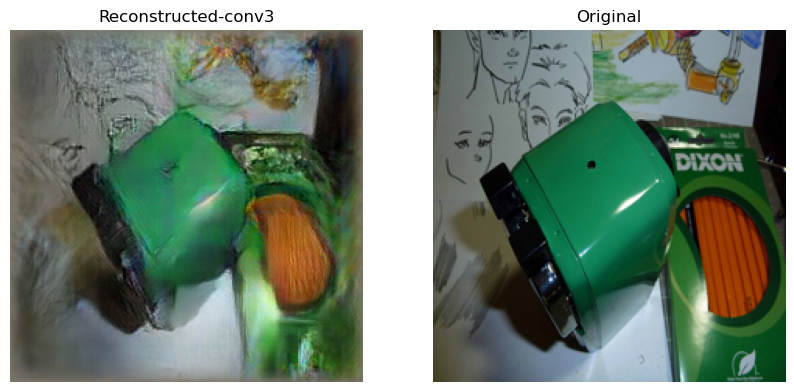

In [113]:
layer = "conv3"
invert_layer_id = invers_layer_map[layer]
G = G_dict[layer]
imgdir = "/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/Datasets/imagenet-valid/valid"
img = Image.open(join(imgdir, "ILSVRC2012_val_00010000.JPEG"))
img = img.resize((227, 227))
img = np.array(img)
RGB_mean = torch.tensor([123.0, 117.0, 104.0])
RGB_mean = torch.reshape(RGB_mean, (1, 3, 1, 1))
img_preproc = torch.from_numpy(img).permute(2, 0, 1).unsqueeze(0).float() # 
img_preproc = (img_preproc - RGB_mean)[:, [2, 1, 0], :, :]
out = CNN.net[:invert_layer_id+1](img_preproc.cuda())
imgtsr_recon_pp = G.visualize(out).cpu()

plt.subplots(1, 2, figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(imgtsr_recon_pp[0].permute(1, 2, 0).detach().cpu().numpy())
plt.title(f"Reconstructed-{layer}")
plt.axis("off")
plt.subplot(1, 2, 2)
plt.imshow(img)
plt.title("Original")
plt.axis("off")
plt.show()

In [8]:
type(CNN)

core.utils.GAN_utils.Caffenet

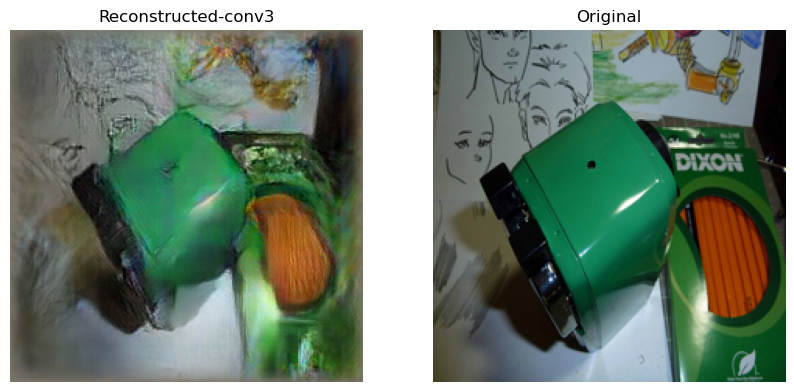

In [10]:
layer = "conv3"
invert_layer_id = invers_layer_map[layer]
G = G_dict[layer]
imgdir = "/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/Datasets/imagenet-valid/valid"
img = Image.open(join(imgdir, "ILSVRC2012_val_00010000.JPEG"))
img = img.resize((227, 227))
img = np.array(img)
RGB_mean = torch.tensor([123.0, 117.0, 104.0])
RGB_mean = torch.reshape(RGB_mean, (1, 3, 1, 1))
img_preproc = torch.from_numpy(img).permute(2, 0, 1).unsqueeze(0).float() # 
img_preproc = (img_preproc - RGB_mean)[:, [2, 1, 0], :, :]
out = CNN.net[:invert_layer_id+1](img_preproc.cuda(), )
imgtsr_recon_pp = G.visualize(out).cpu()

plt.subplots(1, 2, figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(imgtsr_recon_pp[0].permute(1, 2, 0).detach().cpu().numpy())
plt.title(f"Reconstructed-{layer}")
plt.axis("off")
plt.subplot(1, 2, 2)
plt.imshow(img)
plt.title("Original")
plt.axis("off")
plt.show()

In [26]:
import torch.nn.functional as F
from torch.utils.data import DataLoader
from IPython.display import display
from circuit_toolkit.layer_hook_utils import featureFetcher_module
from circuit_toolkit.dataset_utils import create_imagenet_valid_dataset
INroot = "/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/Datasets/imagenet-valid/"
INdataset = create_imagenet_valid_dataset(imgpix=227, normalize=False, rootdir=INroot)

In [22]:
fetcher = featureFetcher_module(store_device="cuda")
for layer in invers_layer_map.keys():
    if layer == "fc6_eucl":
        continue
    fetcher.record_module(CNN.net[invers_layer_map[layer]], target_name=layer, )

norm1


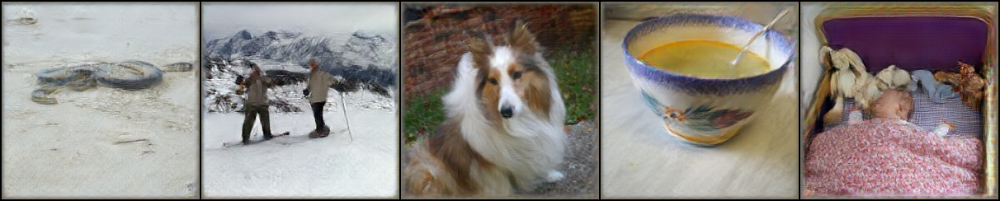

norm2


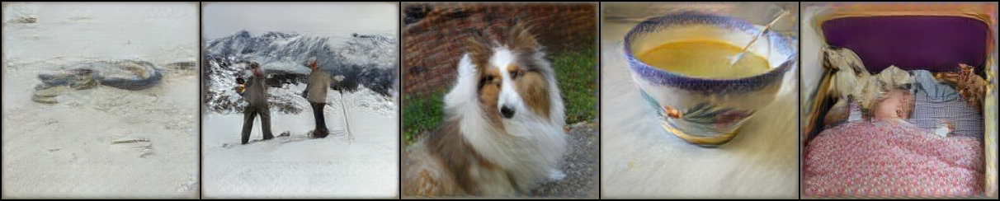

conv3


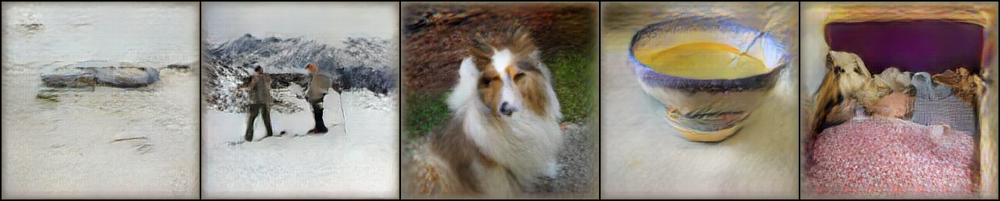

conv4


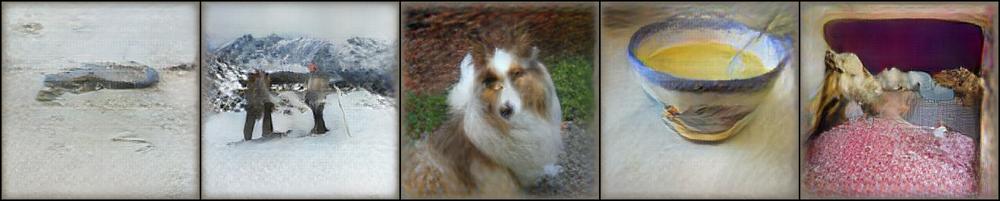

pool5


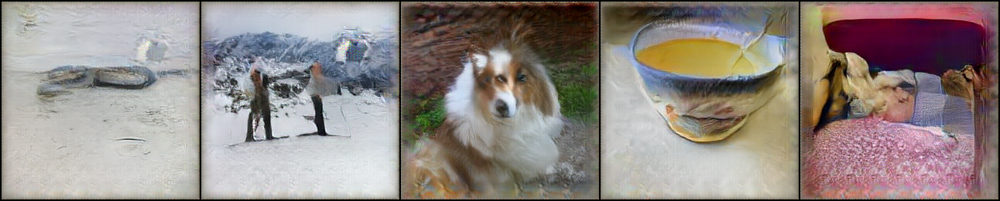

fc6


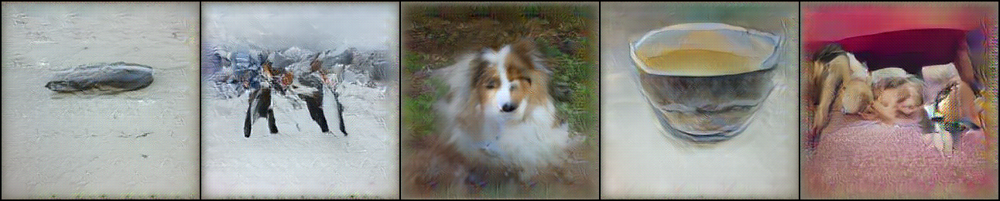

fc7


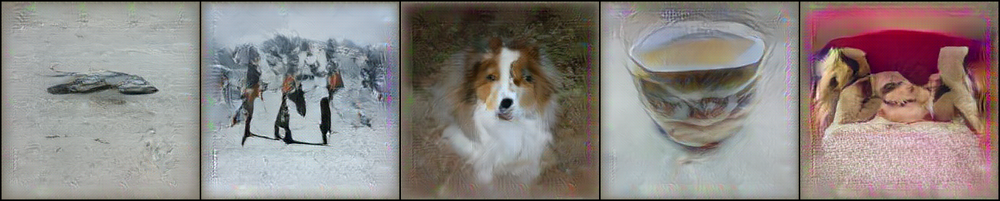

fc8


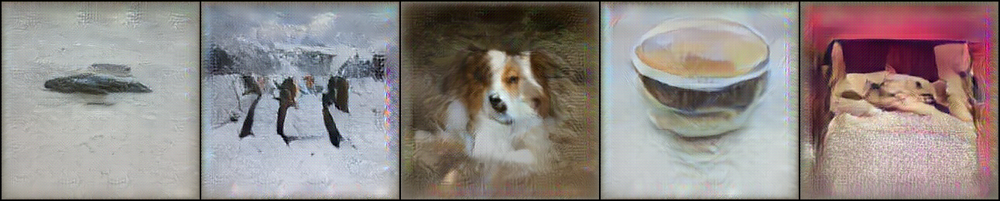

In [99]:
dataloader = DataLoader(INdataset, batch_size=5, shuffle=False, num_workers=0)
imgtsr, _ = next(iter(dataloader))
imgtsr_pp = ((imgtsr * 255.0) - RGB_mean)[:, [2, 1, 0], :, :]
with th.no_grad():
    out = CNN(imgtsr_pp.cuda(), )

recon_img_col = {}
for k, v in fetcher.activations.items():
    print(k)
    recon_img = G_dict[k].visualize(v).cpu()
    # interpolate to 256x256
    recon_img = th.nn.functional.interpolate(recon_img, size=(256, 256), mode="bilinear")
    recon_img_col[k] = recon_img
    # show_imgrid(recon_img, nrow=5)
    display(to_imgrid(recon_img, nrow=5))

Implicit pre-processing of the 

In [27]:
dataloader = DataLoader(INdataset, batch_size=5, shuffle=False, num_workers=0)
imgtsr, _ = next(iter(dataloader))
with th.no_grad():
    out = CNN(imgtsr.cuda(), preproc=True, scale=1.0)

recon_img_col = {}
recon_img_col["original"] = F.interpolate(imgtsr, size=(256, 256), mode="bilinear")
for k, v in fetcher.activations.items():
    print(k)
    recon_img = G_dict[k].visualize(v).cpu()
    # interpolate to 256x256
    recon_img = F.interpolate(recon_img, size=(256, 256), mode="bilinear")
    recon_img_col[k] = recon_img
    # show_imgrid(recon_img, nrow=5)
    # display(to_imgrid(recon_img, nrow=5))

norm1
norm2
conv3
conv4
pool5
fc6
fc7
fc8


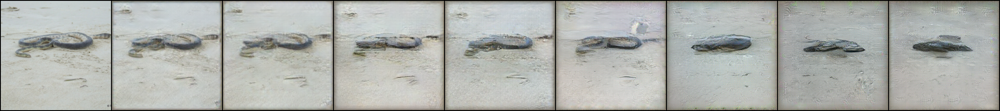

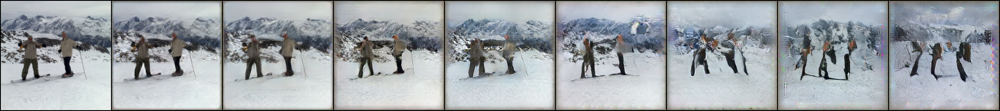

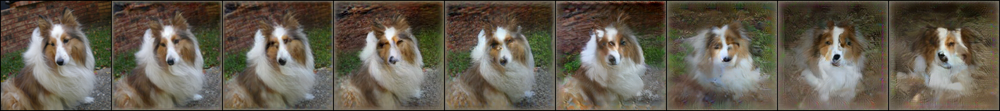

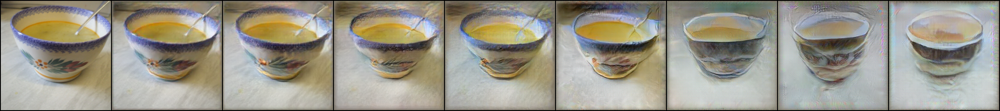

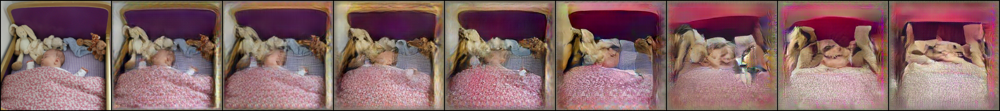

In [28]:
recon_img_tsr = th.stack(list(recon_img_col.values()), dim=0)
for i in range(recon_img_tsr.shape[1]):
    display(to_imgrid(recon_img_tsr[:, i], nrow=9))

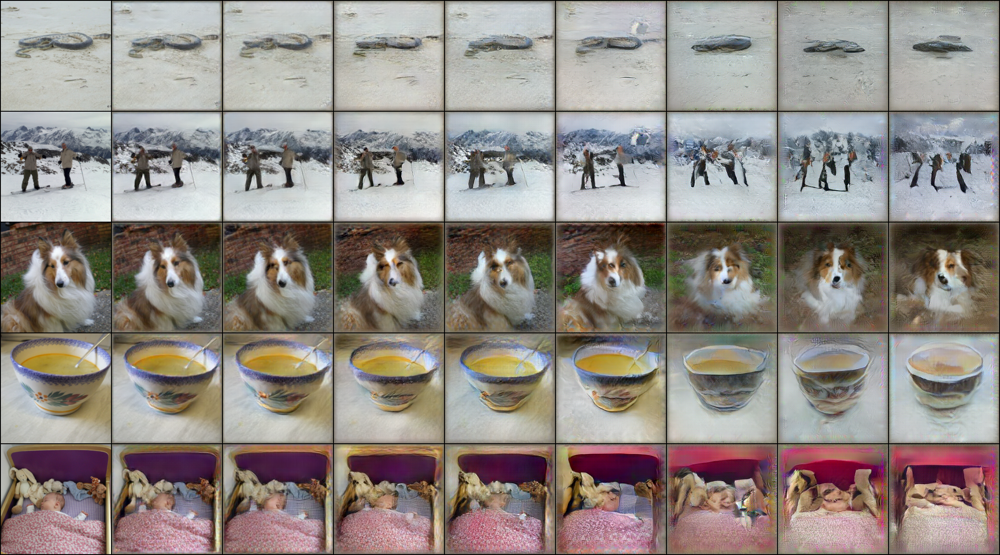

In [29]:
recon_img_tsr = th.stack(list(recon_img_col.values()), dim=0)
display(to_imgrid(recon_img_tsr.transpose(1, 0,).reshape(-1, *recon_img_tsr.shape[-3:]), nrow=9))

In [78]:
fetcher.cleanup()

FeatureFetcher hooks all freed


### Pool5

In [4]:
G = upconvGAN(name="pool5", pretrained=True)
G = G.to("cuda").eval()

downloading weights of `upconvGAN_pool5.pt` to /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/torch_cache/hub/checkpoints/upconvGAN_pool5.pt


50.8MiB [00:03, 13.8MiB/s]


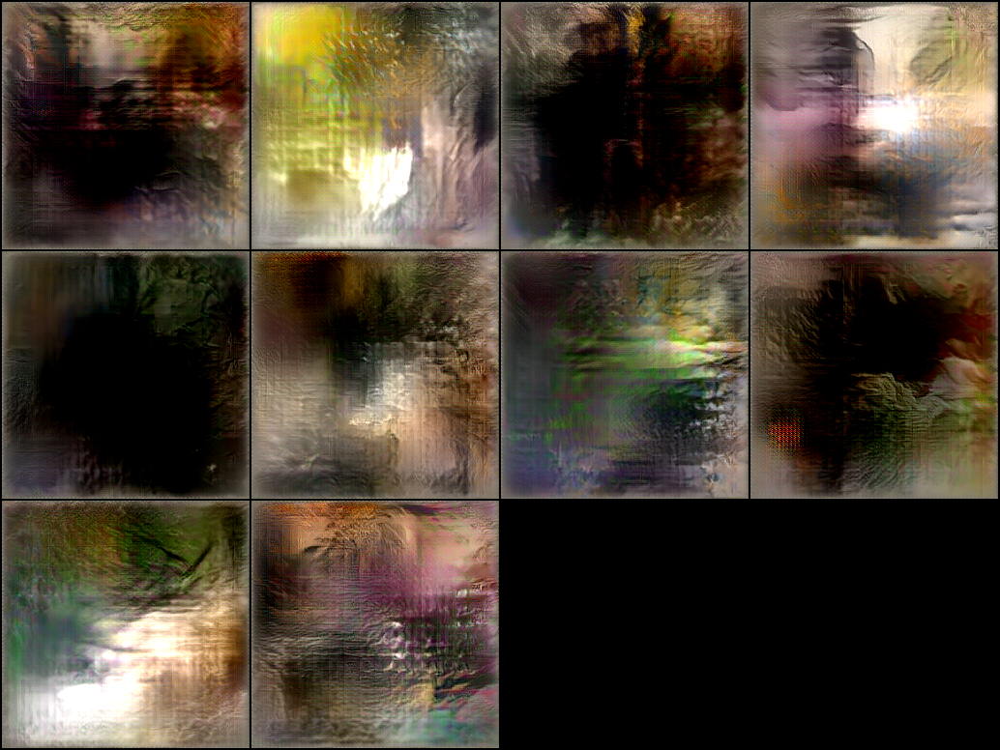

In [15]:
imgtsr = G.visualize(20*th.randn(10, 256, 6, 6).to("cuda"))
show_imgrid(imgtsr, nrow=4)

### FC7

In [26]:
G = upconvGAN(name="fc7", pretrained=True)
G = G.to("cuda").eval()

downloading weights of `upconvGAN_fc7.pt` to /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/torch_cache/hub/checkpoints/upconvGAN_fc7.pt


100%|██████████| 224M/224M [00:05<00:00, 41.6MiB/s] 


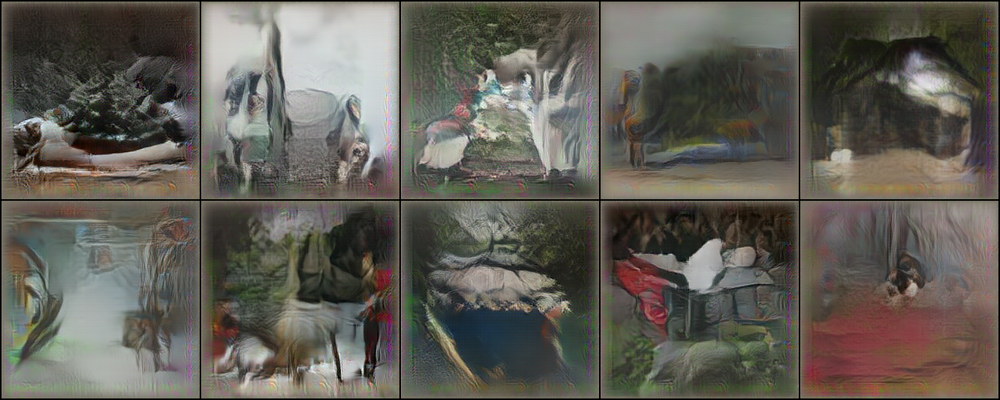

In [29]:
latents = th.randn(10, 4096).to("cuda")
imgtsr = G.visualize(latents)
show_imgrid(imgtsr, nrow=5)

### FC8

In [16]:
G = upconvGAN(name="fc8", pretrained=True)
G = G.to("cuda").eval()

downloading weights of `upconvGAN_fc8.pt` to /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/torch_cache/hub/checkpoints/upconvGAN_fc8.pt


100%|██████████| 174M/174M [00:03<00:00, 47.8MiB/s] 


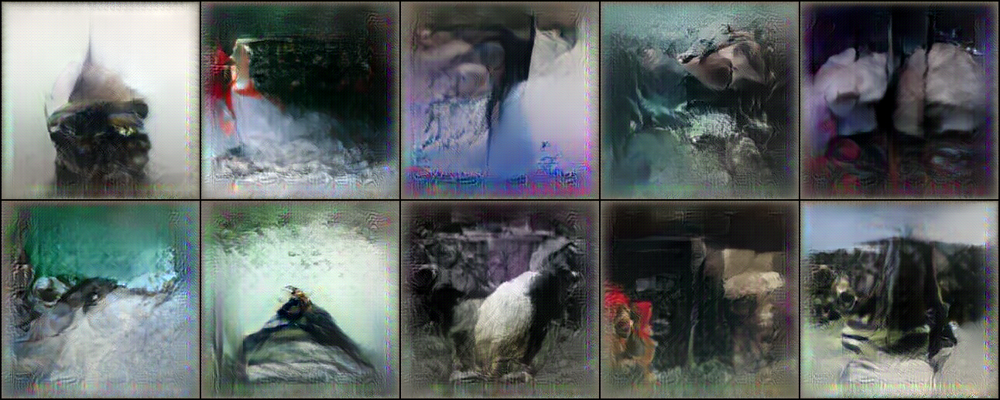

In [25]:
latents = 10*th.eye(1000).to("cuda")[:10, :]
imgtsr = G.visualize(latents)
show_imgrid(imgtsr, nrow=5)

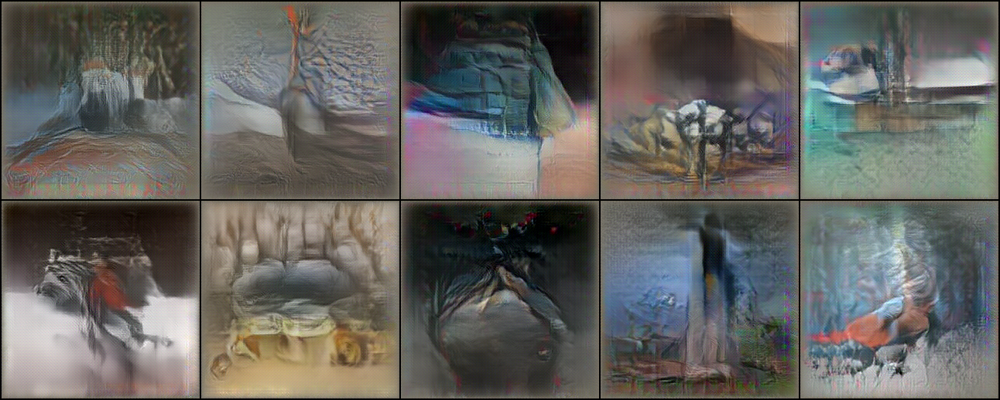

In [24]:
# create one hot vector
latents = th.randn(10, 1000).to("cuda")
imgtsr = G.visualize(latents)
show_imgrid(imgtsr, nrow=5)